# Motion prediction applied to self-driving vehicles

## 1. Competition goal and introduction

Self-driving cars: where are we in 2020? A small video intro:

In [1]:
# a brief explanation is found in this video
from IPython.display import HTML


HTML('<center><iframe  width="850" height="450" src="https://www.youtube.com/watch?v=EzylsrXtkxI" frameborder="0" allow="accelerometer; autoplay; encrypted-media; gyroscope; picture-in-picture" allowfullscreen></iframe></center>')


The goal for this competition is then to predict the motion of extraneous vehicles, people, animals (called "agents").
Full details about the dateset can be found on this academic paper https://arxiv.org/pdf/2006.14480.pdf
In section 2 the most important concept will be introduced. 
In section 3 a predicting model will be proposed.

## 2. Import libraries and  explore data

Before importing/installing libraries I added the following datasets: kaggle-l5kit, lyft-config-files, lyft-resnet18-baseline

### 2.1 basic libraries and l5kit

In [2]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import scipy as sp

import gc
import os
from pathlib import Path
import random
import sys
import yaml
from tqdm.notebook import tqdm





In [3]:
#!pip install --no-index -f ../input/kaggle-l5kit pip==20.2.2 >/dev/nul
#!pip install --no-index -f ../input/kaggle-l5kit -U l5kit > /dev/nul
!pip install --no-index -f /kaggle/input/l5kitwithpytorchlightning pip==20.2.3
!pip install --no-index -f /kaggle/input/l5kitwithpytorchlightning -U l5kit pytorch-lightning


Looking in links: /kaggle/input/l5kitwithpytorchlightning
Processing /kaggle/input/l5kitwithpytorchlightning/pip-20.2.3-py2.py3-none-any.whl
  Attempting uninstall: pip
    Found existing installation: pip 20.2.2
    Uninstalling pip-20.2.2:
      Successfully uninstalled pip-20.2.2
Looking in links: /kaggle/input/l5kitwithpytorchlightning
Processing /kaggle/input/l5kitwithpytorchlightning/l5kit-1.0.6-py3-none-any.whl
Processing /kaggle/input/l5kitwithpytorchlightning/pytorch_lightning-0.9.0-py3-none-any.whl
Processing /kaggle/input/l5kitwithpytorchlightning/pymap3d-2.4.1-py3-none-any.whl
Processing /kaggle/input/l5kitwithpytorchlightning/torchvision-0.6.1-cp37-cp37m-manylinux1_x86_64.whl
Processing /kaggle/input/l5kitwithpytorchlightning/zarr-2.4.0-py3-none-any.whl
Processing /kaggle/input/l5kitwithpytorchlightning/protobuf-3.12.2-cp37-cp37m-manylinux1_x86_64.whl
Processing /kaggle/input/l5kitwithpytorchlightning/opencv_contrib_python_headless-4.4.0.42-cp37-cp37m-manylinux2014_x86_64.

In [4]:
!pip install --quiet pymap3d==2.1.0
!pip install -U --quiet l5kit

In [5]:
## this script transports l5kit and dependencies


import l5kit
print ('l5kit imported')
print("l5kit version:", l5kit.__version__)

l5kit imported
l5kit version: 1.0.6


In [6]:
 !pip3 install resnet_pytorch

In [7]:
from l5kit.configs import load_config_data
from l5kit.data import LocalDataManager, ChunkedDataset
from l5kit.data import PERCEPTION_LABELS
from l5kit.dataset import AgentDataset, EgoDataset
from l5kit.rasterization import build_rasterizer
from itertools import islice
from typing import Dict




from l5kit.evaluation.csv_utils import write_pred_csv
from l5kit.evaluation import compute_metrics_csv, read_gt_csv, create_chopped_dataset
from l5kit.evaluation.chop_dataset import MIN_FUTURE_STEPS
from l5kit.evaluation.metrics import neg_multi_log_likelihood, time_displace
from l5kit.geometry import transform_points
from l5kit.visualization import PREDICTED_POINTS_COLOR, TARGET_POINTS_COLOR, draw_trajectory


from l5kit.configs import load_config_data


from tqdm import tqdm
from collections import Counter

from prettytable import PrettyTable


from IPython.display import display, clear_output
from IPython.display import HTML

import PIL
import matplotlib.pyplot as plt
from matplotlib import animation, rc
rc('animation', html='jshtml')




In [8]:


# --- plotly ---
from plotly import tools, subplots
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.express as px
import plotly.figure_factory as ff
import plotly.io as pio
pio.templates.default = "plotly_dark"

# --- models ---
from sklearn import preprocessing
from sklearn.model_selection import KFold

import torch
from torch import nn, optim


from torchvision.models.resnet import resnet50, resnet18, resnet34, resnet101
from torch import nn
from torch import Tensor
from typing import Dict
from pathlib import Path



from torch import nn, optim
from torch.utils.data import DataLoader
from torch.utils.data.dataset import Subset


import torchvision
import pytorch_lightning as pl

### 2.2 Data import

The dataset consists of 170,000 scenes capturing the environment around the autonomous vehicle. Each scene encodes the state of the vehicle’s surroundings at a given point in time. 

In [9]:
l5kit_data_folder = "../input/lyft-motion-prediction-autonomous-vehicles"
os.environ["L5KIT_DATA_FOLDER"] = l5kit_data_folder


In [10]:
#MODEL_NAME = "wide_resnet101_2"
IMG_SIZE = 224
# --- Lyft configs ---
cfg = {
          'model_params': {'model_architecture': 'resnet101',
          'history_num_frames': 10,
        'history_step_size': 1,
        'history_delta_time': 0.1,
        'future_num_frames': 50,
        'future_step_size': 1,
        'future_delta_time': 0.1,
        'model_name': "model_resnet101_output",
        'lr': 1e-4,
        
        'train': True,
        'predict': True},

        'raster_params': {'raster_size': [IMG_SIZE, IMG_SIZE],
          'pixel_size': [0.5, 0.5],
          'ego_center': [0.25, 0.5],
          'map_type': 'py_semantic',
          'satellite_map_key': 'aerial_map/aerial_map.png',
          'semantic_map_key': 'semantic_map/semantic_map.pb',
          'dataset_meta_key': 'meta.json',
          'filter_agents_threshold': 0.5},

        'train_data_loader': {'key': 'scenes/train.zarr',
          'batch_size': 8,
          'shuffle': True,
          'num_workers': 16},

        "valid_data_loader":{"key": "scenes/validate.zarr",
                            "batch_size": 8,
                            "shuffle": False,
                            "num_workers": 4},
    
        "sample_data_loader": {
        'key': 'scenes/sample.zarr',
        'batch_size': 12,
        'shuffle': False,
        'num_workers': 16},
         
        "test_data_loader":{
        'key': "scenes/test.zarr",
        'batch_size': 8,
        'shuffle': False,
        'num_workers': 4},

    
        'train_params': {'checkpoint_every_n_steps': 100,
          'max_num_steps':600,
          'eval_every_n_steps': 60}
        }
print(cfg)

{'model_params': {'model_architecture': 'resnet101', 'history_num_frames': 10, 'history_step_size': 1, 'history_delta_time': 0.1, 'future_num_frames': 50, 'future_step_size': 1, 'future_delta_time': 0.1, 'model_name': 'model_resnet101_output', 'lr': 0.0001, 'train': True, 'predict': True}, 'raster_params': {'raster_size': [224, 224], 'pixel_size': [0.5, 0.5], 'ego_center': [0.25, 0.5], 'map_type': 'py_semantic', 'satellite_map_key': 'aerial_map/aerial_map.png', 'semantic_map_key': 'semantic_map/semantic_map.pb', 'dataset_meta_key': 'meta.json', 'filter_agents_threshold': 0.5}, 'train_data_loader': {'key': 'scenes/train.zarr', 'batch_size': 8, 'shuffle': True, 'num_workers': 16}, 'valid_data_loader': {'key': 'scenes/validate.zarr', 'batch_size': 8, 'shuffle': False, 'num_workers': 4}, 'sample_data_loader': {'key': 'scenes/sample.zarr', 'batch_size': 12, 'shuffle': False, 'num_workers': 16}, 'test_data_loader': {'key': 'scenes/test.zarr', 'batch_size': 8, 'shuffle': False, 'num_workers':

### 2.3 Data exploration

Credits to https://www.kaggle.com/nxrprime/lyft-understanding-the-data-baseline-on-tpus

Input data files are available in the read-only "../input/" directory.
The dataset is structured as follows:
- aerial_map
- scenes
- semantic_map

Aerial map subfolder contains images. Scenes subfolder contains information about foreing street objects classified in zarr files as following

- sample.zarr
- test.zarr
- train.zarr
- validate.zarr

For who never heard about "zarr" (for Italians, nothing to do with "zarro"):

"Zarr" provides classes and functions for working with N-dimensional arrays that behave like NumPy arrays but whose data is divided into chunks and each chunk is compressed.
Useful for handling big data.
More info at http://alimanfoo.github.io/2016/04/14/to-hdf5-and-beyond.html

The dataset consists of frames and agent states. A frame is a snapshot in time which consists of ego pose, time, and multiple agent states. Each agent state describes the position, orientation, bounds, and type.

sample.zarr data is used for visualization, train.zarr / validate.zarr / test.zarr are those needed for actual model training/validation/prediction.
We're building a LocalDataManager object. This will resolve relative paths from the config using the L5KIT_DATA_FOLDER env variable that was set above.

In [11]:
dm = LocalDataManager()
dataset_path = dm.require(cfg["sample_data_loader"]["key"]) # for the EDA we use samples dataset. Smaller and RAM-ready
zarr_dataset = ChunkedDataset(dataset_path)
zarr_dataset.open()
print(zarr_dataset)



+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|    100     |   24838    |  1893736   |       0.69      |        248.38        |        76.24         |        24.83         |        10.00        |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+


#### Instead of working with raw data, L5Kit provides PyTorch ready datasets. It's much easier to use this wrapped dataset class to access data.

2 dataset class is implemented.

    EgoDataset: this dataset iterates over the AV (Autonomous Vehicle) annotations
    AgentDataset: this dataset iterates over other agents annotations

Let's see each class in detail. What kind of attributes/methods they have? What kind of data structure for each attributes?

As written in Class diagram, both classes are instantiated by:

    cfg: configuration file
    ChunkedDataset: Internal data class which holds 4 raw data scenes, frames, agents and tl_faces (described later).
    rasterizer: Rasterizer converts raw data into image.


### 2.4 Data examples

#### Objects in our maps, defined as "agents"

In [12]:
agents = zarr_dataset.agents
probabilities = agents["label_probabilities"]
labels_indexes = np.argmax(probabilities, axis=1)
counts = []
for idx_label, label in enumerate(PERCEPTION_LABELS):
    counts.append(np.sum(labels_indexes == idx_label))
    
table = PrettyTable(field_names=["label", "counts"])
for count, label in zip(counts, PERCEPTION_LABELS):
    table.add_row([label, count])
print(table)

+------------------------------------+---------+
|               label                |  counts |
+------------------------------------+---------+
|      PERCEPTION_LABEL_NOT_SET      |    0    |
|      PERCEPTION_LABEL_UNKNOWN      | 1324481 |
|     PERCEPTION_LABEL_DONTCARE      |    0    |
|        PERCEPTION_LABEL_CAR        |  519385 |
|        PERCEPTION_LABEL_VAN        |    0    |
|       PERCEPTION_LABEL_TRAM        |    0    |
|        PERCEPTION_LABEL_BUS        |    0    |
|       PERCEPTION_LABEL_TRUCK       |    0    |
| PERCEPTION_LABEL_EMERGENCY_VEHICLE |    0    |
|   PERCEPTION_LABEL_OTHER_VEHICLE   |    0    |
|      PERCEPTION_LABEL_BICYCLE      |    0    |
|    PERCEPTION_LABEL_MOTORCYCLE     |    0    |
|      PERCEPTION_LABEL_CYCLIST      |   6688  |
|   PERCEPTION_LABEL_MOTORCYCLIST    |    0    |
|    PERCEPTION_LABEL_PEDESTRIAN     |  43182  |
|      PERCEPTION_LABEL_ANIMAL       |    0    |
|     AVRESEARCH_LABEL_DONTCARE      |    0    |
+-------------------

#### Aerial map showing the "ego" vehicle trajectory and animation including agents 

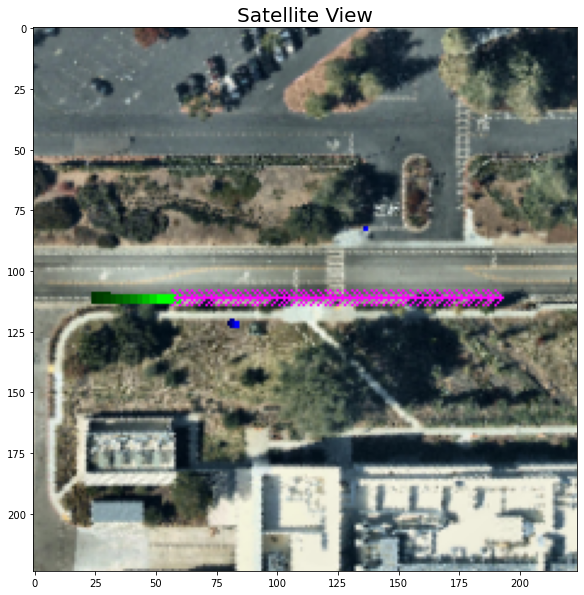

In [13]:
cfg["raster_params"]["map_type"] = "py_satellite"
rast = build_rasterizer(cfg, dm)
dataset = EgoDataset(cfg, zarr_dataset, rast)
data = dataset[80]

im = data["image"].transpose(1, 2, 0)
im = dataset.rasterizer.to_rgb(im)
target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)
figsize = plt.subplots(figsize = (10,10))
plt.title('Satellite View',fontsize=20)
plt.imshow(im[::-1])
plt.show()


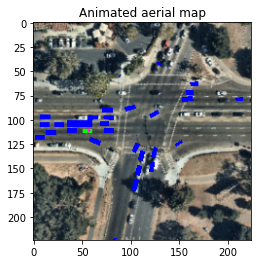

In [14]:
def animate_solution(images):

    def animate(i):
        im.set_data(images[i])
 
    fig, ax = plt.subplots()
    im = ax.imshow(images[0])
    plt.title('Animated aerial map')
    return animation.FuncAnimation(fig, animate, frames=len(images), interval=60)

cfg["raster_params"]["map_type"] = "py_satellite"
rast = build_rasterizer(cfg, dm)
dataset = EgoDataset(cfg, zarr_dataset, rast)
scene_idx = 34
indexes = dataset.get_scene_indices(scene_idx)
images = []

for idx in indexes:
    
    data = dataset[idx]
    im = data["image"].transpose(1, 2, 0)
    im = dataset.rasterizer.to_rgb(im)
    target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
    center_in_pixels = np.asarray(cfg["raster_params"]["ego_center"]) * cfg["raster_params"]["raster_size"]
    draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)
    clear_output(wait=True)
    images.append(PIL.Image.fromarray(im[::-1]))
anim = animate_solution(images)
HTML(anim.to_jshtml())


#### Semantic map, animated


Meaning of color in semantic map?

Looking the code, I see that

    default lane color is "light yellow" (255, 217, 82). code
    green, yellow, red color on lane is to show trafic light condition. code
    orange box represents crosswalk. code

Please refer below animation to verify it.


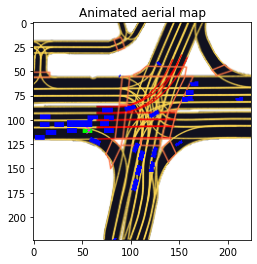

In [15]:
cfg["raster_params"]["map_type"] = "py_semantic"
# Rasterizer
rast = build_rasterizer(cfg, dm)

dataset = EgoDataset(cfg, zarr_dataset, rast)
scene_idx = 34
indexes = dataset.get_scene_indices(scene_idx)
images = []

for idx in indexes:
    
    data = dataset[idx]
    im = data["image"].transpose(1, 2, 0)
    im = dataset.rasterizer.to_rgb(im)
    target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
    center_in_pixels = np.asarray(cfg["raster_params"]["ego_center"]) * cfg["raster_params"]["raster_size"]
    draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)
    clear_output(wait=True)
    images.append(PIL.Image.fromarray(im[::-1]))
    
anim = animate_solution(images)
HTML(anim.to_jshtml())

## 3. Define model datasets 

In [16]:
# ===== INIT TRAIN DATASET============================================================
train_cfg = cfg["train_data_loader"]
rasterizer = build_rasterizer(cfg, dm)
train_zarr = ChunkedDataset(dm.require(train_cfg["key"])).open()
train_dataset = AgentDataset(cfg, train_zarr, rasterizer)
train_dataloader = DataLoader(train_dataset, shuffle=train_cfg["shuffle"], batch_size=train_cfg["batch_size"], 
                             num_workers=train_cfg["num_workers"])
print("==================================TRAIN DATA==================================")
print(train_dataset)

==================================TRAIN DATA==================================
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|   16265    |  4039527   | 320124624  |      112.19     |        248.36        |        79.25         |        24.83         |        10.00        |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+


In [17]:
# ===== INIT VALIDATION DATASET============================================================
valid_cfg = cfg["valid_data_loader"]
rasterizer = build_rasterizer(cfg, dm)
validate_zarr = ChunkedDataset(dm.require(valid_cfg["key"])).open()
valid_dataset = AgentDataset(cfg, validate_zarr, rasterizer)
valid_dataloader = DataLoader(valid_dataset, shuffle=valid_cfg["shuffle"], batch_size=valid_cfg["batch_size"], 
                             num_workers=valid_cfg["num_workers"])
print("==================================VALIDATION DATA==================================")
print(valid_dataset)

==================================VALIDATION DATA==================================
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|   16220    |  4030296   | 312617887  |      111.97     |        248.48        |        77.57         |        24.85         |        10.00        |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+


## 4. Predicting model

For this competition it is important to use the correct loss function when train the model. Our goal is to predict three possible paths together with the confidence score, so we need to use the loss function that takes that into account, simply using RMSE will not lead to an accurate model. 

In [18]:
# --- Function utils ---
# Original code from https://github.com/lyft/l5kit/blob/20ab033c01610d711c3d36e1963ecec86e8b85b6/l5kit/l5kit/evaluation/metrics.py




def pytorch_neg_multi_log_likelihood_batch(
    gt: Tensor, pred: Tensor, confidences: Tensor, avails: Tensor
) -> Tensor:
    """
    Compute a negative log-likelihood for the multi-modal scenario.
    log-sum-exp trick is used here to avoid underflow and overflow, For more information about it see:
    https://en.wikipedia.org/wiki/LogSumExp#log-sum-exp_trick_for_log-domain_calculations
    https://timvieira.github.io/blog/post/2014/02/11/exp-normalize-trick/
    https://leimao.github.io/blog/LogSumExp/
    Args:
        gt (Tensor): array of shape (bs)x(time)x(2D coords)
        pred (Tensor): array of shape (bs)x(modes)x(time)x(2D coords)
        confidences (Tensor): array of shape (bs)x(modes) with a confidence for each mode in each sample
        avails (Tensor): array of shape (bs)x(time) with the availability for each gt timestep
    Returns:
        Tensor: negative log-likelihood for this example, a single float number
    """
    assert len(pred.shape) == 4, f"expected 3D (MxTxC) array for pred, got {pred.shape}"
    batch_size, num_modes, future_len, num_coords = pred.shape

    assert gt.shape == (batch_size, future_len, num_coords), f"expected 2D (Time x Coords) array for gt, got {gt.shape}"
    assert confidences.shape == (batch_size, num_modes), f"expected 1D (Modes) array for gt, got {confidences.shape}"
    assert torch.allclose(torch.sum(confidences, dim=1), confidences.new_ones((batch_size,))), "confidences should sum to 1"
    assert avails.shape == (batch_size, future_len), f"expected 1D (Time) array for gt, got {avails.shape}"
    # assert all data are valid
    assert torch.isfinite(pred).all(), "invalid value found in pred"
    assert torch.isfinite(gt).all(), "invalid value found in gt"
    assert torch.isfinite(confidences).all(), "invalid value found in confidences"
    assert torch.isfinite(avails).all(), "invalid value found in avails"

    # convert to (batch_size, num_modes, future_len, num_coords)
    gt = torch.unsqueeze(gt, 1)  # add modes
    avails = avails[:, None, :, None]  # add modes and cords

    # error (batch_size, num_modes, future_len)
    error = torch.sum(((gt - pred) * avails) ** 2, dim=-1)  # reduce coords and use availability

    with np.errstate(divide="ignore"):  # when confidence is 0 log goes to -inf, but we're fine with it
        # error (batch_size, num_modes)
        error = torch.log(confidences) - 0.5 * torch.sum(error, dim=-1)  # reduce time

    # use max aggregator on modes for numerical stability
    # error (batch_size, num_modes)
    max_value, _ = error.max(dim=1, keepdim=True)  # error are negative at this point, so max() gives the minimum one
    error = -torch.log(torch.sum(torch.exp(error - max_value), dim=-1, keepdim=True)) - max_value  # reduce modes
    # print("error", error)
    return torch.mean(error)


def pytorch_neg_multi_log_likelihood_single(
    gt: Tensor, pred: Tensor, avails: Tensor
) -> Tensor:
    """

    Args:
        gt (Tensor): array of shape (bs)x(time)x(2D coords)
        pred (Tensor): array of shape (bs)x(time)x(2D coords)
        avails (Tensor): array of shape (bs)x(time) with the availability for each gt timestep
    Returns:
        Tensor: negative log-likelihood for this example, a single float number
    """
    # pred (bs)x(time)x(2D coords) --> (bs)x(mode=1)x(time)x(2D coords)
    # create confidence (bs)x(mode=1)
    batch_size, future_len, num_coords = pred.shape
    confidences = pred.new_ones((batch_size, 1))
    return pytorch_neg_multi_log_likelihood_batch(gt, pred.unsqueeze(1), confidences, avails)


In [19]:
class LyftMultiModel(nn.Module):

    def __init__(self, cfg: Dict, num_modes=3):
        super().__init__()

        architecture = cfg["model_params"]["model_architecture"]
        backbone = eval(architecture)(pretrained=True, progress=True)
        self.backbone = backbone

        num_history_channels = (cfg["model_params"]["history_num_frames"] + 1) * 2
        num_in_channels = 3 + num_history_channels

        self.backbone.conv1 = nn.Conv2d(
            num_in_channels,
            self.backbone.conv1.out_channels,
            kernel_size=self.backbone.conv1.kernel_size,
            stride=self.backbone.conv1.stride,
            padding=self.backbone.conv1.padding,
            bias=False,
        )

        # This is 512 for resnet18 and resnet34;
        # And it is 2048 for the other resnets
        
        backbone_out_features = 2048
        
        # X, Y coords for the future positions (output shape: batch_sizex50x2)
        self.future_len = cfg["model_params"]["future_num_frames"]
        num_targets = 2 * self.future_len

        # You can add more layers here.
        self.head = nn.Sequential(
            # nn.Dropout(0.2),
            nn.Linear(in_features=backbone_out_features, out_features=4096),
        )

        self.num_preds = num_targets * num_modes
        self.num_modes = num_modes

        self.logit = nn.Linear(4096, out_features=self.num_preds + num_modes)

    def forward(self, x):
        x = self.backbone.conv1(x)
        x = self.backbone.bn1(x)
        x = self.backbone.relu(x)
        x = self.backbone.maxpool(x)

        x = self.backbone.layer1(x)
        x = self.backbone.layer2(x)
        x = self.backbone.layer3(x)
        x = self.backbone.layer4(x)

        x = self.backbone.avgpool(x)
        x = torch.flatten(x, 1)

        x = self.head(x)
        x = self.logit(x)

        # pred (batch_size)x(modes)x(time)x(2D coords)
        # confidences (batch_size)x(modes)
        bs, _ = x.shape
        pred, confidences = torch.split(x, self.num_preds, dim=1)
        pred = pred.view(bs, self.num_modes, self.future_len, 2)
        assert confidences.shape == (bs, self.num_modes)
        confidences = torch.softmax(confidences, dim=1)
        return pred, confidences

In [20]:
def forward(data, model, device, criterion = pytorch_neg_multi_log_likelihood_batch):
    inputs = data["image"].to(device)
    target_availabilities = data["target_availabilities"].to(device)
    targets = data["target_positions"].to(device)
    # Forward pass
    preds, confidences = model(inputs)
    
    loss = criterion(targets, preds, confidences, target_availabilities)
    return loss, preds

## Train model

In [21]:

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = LyftMultiModel(cfg)

#load weight if there is a pretrained model
WEIGHT_FILE = None
VALIDATION = True  #A hyperparameter you could use to toggle for validating the model


Downloading: "https://download.pytorch.org/models/resnet101-5d3b4d8f.pth" to /root/.cache/torch/checkpoints/resnet101-5d3b4d8f.pth


In [22]:
model.to(device)
optimizer = optim.Adam(model.parameters(), lr=cfg["model_params"]["lr"])
print(f'device {device}')

device cuda:0


In [23]:
def train(train_dataloader, valid_dataloader, opt=None, criterion=None, lrate=1e-4):
        """Function for training the model"""
        print("Building Model...")
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        model = LyftMultiModel(cfg)
        
        model.to(device)
        optimizer = optim.Adam(model.parameters(), lr=cfg["model_params"]["lr"])
        criterion = pytorch_neg_multi_log_likelihood_batch
                             
                
        print("Training...")
        losses = []
        losses_mean = []
        val_losses = []
        val_losses_mean = []
        progress = tqdm(range(cfg["train_params"]["max_num_steps"]))
        train_iter = iter(train_dataloader)
        val_iter = iter(valid_dataloader)
        
        for i in progress:
            try:
                data = next(train_iter)
            except StopIteration:
                train_iter = iter(train_dataloader)
                data = next(train_iter)
                    
            model.train()
            torch.set_grad_enabled(True)
                    
            loss, _ = forward(data, model, device, criterion)
                    
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # Validation
            if VALIDATION:
                with torch.no_grad():
                    try:
                        val_data = next(val_iter)
                    except StopIteration:
                        val_iter = iter(val_dataloader)
                        val_data = next(val_iter)

                    val_loss, _  = forward(val_data, model, device, criterion)
                    val_losses.append(val_loss.item())
                    val_losses_mean.append(np.mean(val_losses))
                    
                desc = f"Loss: {round(loss.item(), 4)} Validation Loss: {round(val_loss.item(), 4)}"
            else:
                desc = f"Loss: {round(loss.item(), 4)}"
                
            if len(losses)>0 and loss < min(losses):
                print(f"Loss improved from {min(losses)} to {loss}")
                
                
            losses.append(loss.item())
            losses_mean.append(np.mean(losses))
            progress.set_description(desc)
            
        return losses_mean, val_losses_mean, model

In [24]:
losses, val_losses, model = train(train_dataloader, valid_dataloader)

Building Model...


  0%|          | 0/600 [00:00<?, ?it/s]

Training...


Loss: 1098.1414 Validation Loss: 73.5463:   0%|          | 2/600 [00:24<2:46:35, 16.72s/it]

Loss improved from 2927.3486328125 to 1098.141357421875


Loss: 401.484 Validation Loss: 44.1952:   1%|          | 5/600 [00:27<1:02:31,  6.31s/it]

Loss improved from 1098.141357421875 to 401.4840393066406


Loss: 225.493 Validation Loss: 284.8318:   3%|▎         | 19/600 [00:40<09:25,  1.03it/s]

Loss improved from 401.4840393066406 to 225.4930419921875


Loss: 125.6326 Validation Loss: 273.3468:   4%|▎         | 22/600 [00:43<09:20,  1.03it/s]

Loss improved from 225.4930419921875 to 125.63255310058594


Loss: 112.5149 Validation Loss: 525.2238:   5%|▌         | 32/600 [00:51<08:32,  1.11it/s]

Loss improved from 125.63255310058594 to 112.51493835449219


Loss: 25.824 Validation Loss: 1341.8794:   8%|▊         | 47/600 [01:06<08:52,  1.04it/s]

Loss improved from 112.51493835449219 to 25.82404327392578


Loss: 14.596 Validation Loss: 7851.5015:   9%|▉         | 53/600 [01:11<08:07,  1.12it/s]

Loss improved from 25.82404327392578 to 14.5960111618042


Loss: 9.7005 Validation Loss: 9751.0195:  36%|███▌      | 216/600 [03:42<05:38,  1.13it/s]

Loss improved from 14.5960111618042 to 9.700467109680176


Loss: 367.6779 Validation Loss: 4416.6089: 100%|██████████| 600/600 [10:11<00:00,  1.02s/it]


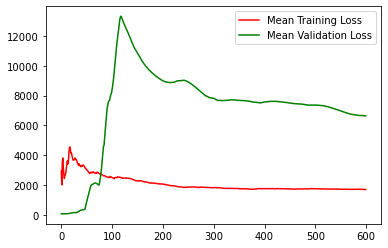

In [25]:
# Training Analysis
plt.plot(losses, c="red", label="Mean Training Loss")
plt.plot(val_losses, c="green", label="Mean Validation Loss")
plt.legend()
plt.show()

In [26]:
print("Saving the model...")
torch.save(model.state_dict(), "lyft_model.pth")
print('model saved')

Saving the model...
model saved


In [27]:
PATH_TO_DATA = '/kaggle/input/lyft-motion-prediction-autonomous-vehicles/'

test_cfg = cfg["test_data_loader"]

# Rasterizer
rasterizer = build_rasterizer(cfg, dm)

# Test dataset/dataloader
test_zarr = ChunkedDataset(dm.require(test_cfg["key"])).open()
test_mask = np.load(f"{PATH_TO_DATA}/scenes/mask.npz")["arr_0"]
test_dataset = AgentDataset(cfg, test_zarr, rasterizer, agents_mask=test_mask)
test_dataloader = DataLoader(test_dataset,
                             shuffle=test_cfg["shuffle"],
                             batch_size=test_cfg["batch_size"],
                             num_workers=test_cfg["num_workers"])


print(test_dataset)



warning, you're running with a custom agents_mask
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|   11314    |  1131400   |  88594921  |      31.43      |        100.00        |        78.31         |        10.00         |        10.00        |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+


In [28]:
# ==== EVAL LOOP ================================================================
if cfg["model_params"]["predict"]:
    
    model.eval()
    torch.set_grad_enabled(False)

    # store information for evaluation
    future_coords_offsets_pd = []
    timestamps = []
    confidences_list = []
    agent_ids = []

    progress_bar = tqdm(test_dataloader)
    for data in progress_bar:
        inputs = data['image'].to(device)
        preds, confidences  = model(inputs)
        future_coords_offsets_pd.append(preds.cpu().numpy().copy())
        confidences_list.append(confidences.cpu().numpy().copy())
        timestamps.append(data["timestamp"].numpy().copy())
        agent_ids.append(data["track_id"].numpy().copy())
        
    #create submission to submit to Kaggle
    pred_path = 'submission.csv'
    write_pred_csv(pred_path,
               timestamps=np.concatenate(timestamps),
               track_ids=np.concatenate(agent_ids),
               coords=np.concatenate(future_coords_offsets_pd),
               confs = np.concatenate(confidences_list)
              )

100%|██████████| 8891/8891 [1:11:24<00:00,  2.08it/s]
